In [ ]:
!git clone https://github.com/ultralytics/yolov5  # clone repo
%cd yolov5
#temporary until bug is fixed in current master
!git reset --hard 5ba1de0cdcc414c69ceb7a4c45eb1e3895eca32a
%cd /content

!pip install -r yolov5/requirements.txt  # install dependencies
%cd yolov5

import torch
from IPython.display import Image, clear_output  # to display images
from utils.google_utils import gdrive_download  # to download models/datasets

clear_output()
print('Setup complete. Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

Setup complete. Using torch 1.5.1+cu101 _CudaDeviceProperties(name='Tesla P100-PCIE-16GB', major=6, minor=0, total_memory=16280MB, multi_processor_count=56)


In [ ]:
# Export code snippet and paste here
%cd /content
!curl -L "https://app.roboflow.ai/ds/SaMcip13Ss?key=QqD7XviHv2" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip


/content
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   896  100   896    0     0   1141      0 --:--:-- --:--:-- --:--:--  1139
100  108M  100  108M    0     0  57.6M      0  0:00:01  0:00:01 --:--:--  162M
Archive:  roboflow.zip
 extracting: test/images/4bdcb2c78_jpg.rf.10e0bcaa279b30bcd164f851655e81a3.jpg  
 extracting: test/images/6c9cf179f_jpg.rf.1b4fb138c96863d0ccf40d7fb359bc35.jpg  
 extracting: test/images/24a832fa5_jpg.rf.2aa55c7e635c4d3759073449914ab93d.jpg  
 extracting: test/images/0dbfcf802_jpg.rf.3e68949a6be06b2db99a0e6caafe93c9.jpg  
 extracting: test/images/2ffc9e0d3_jpg.rf.2b72ce92ac2e8775320d3acf24007809.jpg  
 extracting: test/images/2ccb37ea9_jpg.rf.57834305fe37f87476c4bf7f489ac9b9.jpg  
 extracting: test/images/3a4672486_jpg.rf.26d90d8902640a4d685bd6bea716bbeb.jpg  
 extracting: test/images/2d2c79df1_jpg.rf.50bcc28b3399e78600fc90e0ea4e12de.jpg  
 ext

In [ ]:
# this is the YAML file Roboflow wrote for us that we're loading into this notebook with our data
%cat data.yaml

train: ../train/images
val: ../valid/images

nc: 1
names: ['wheat']

In [ ]:
# define number of classes based on YAML
import yaml
with open("data.yaml", 'r') as stream:
    num_classes = str(yaml.safe_load(stream)['nc'])

In [ ]:
%cd /content/
##write custom model .yaml
#you can configure this based on other YOLOv5 models in the models directory
with open('yolov5/models/custom_yolov5s.yaml', 'w') as f:
  # parameters
  f.write('nc: ' + num_classes + '\n')
  #f.write('nc: ' + str(len(class_labels)) + '\n')
  f.write('depth_multiple: 0.33'  + '\n') # model depth multiple
  f.write('width_multiple: 0.50'  + '\n')  # layer channel multiple
  f.write('\n')
  f.write('anchors:' + '\n')
  f.write('  - [10,13, 16,30, 33,23] ' + '\n')
  f.write('  - [30,61, 62,45, 59,119]' + '\n')
  f.write('  - [116,90, 156,198, 373,326] ' + '\n')
  f.write('\n')

  f.write('backbone:' + '\n')
  f.write('  [[-1, 1, Focus, [64, 3]],' + '\n')
  f.write('   [-1, 1, Conv, [128, 3, 2]],' + '\n')
  f.write('   [-1, 3, Bottleneck, [128]],' + '\n')
  f.write('   [-1, 1, Conv, [256, 3, 2]],' + '\n')
  f.write('   [-1, 9, BottleneckCSP, [256]],' + '\n')
  f.write('   [-1, 1, Conv, [512, 3, 2]], ' + '\n')
  f.write('   [-1, 9, BottleneckCSP, [512]],' + '\n')
  f.write('   [-1, 1, Conv, [1024, 3, 2]],' + '\n')
  f.write('   [-1, 1, SPP, [1024, [5, 9, 13]]],' + '\n')
  f.write('   [-1, 6, BottleneckCSP, [1024]],' + '\n')
  f.write('  ]' + '\n')
  f.write('\n')

  f.write('head:'  + '\n')
  f.write('  [[-1, 3, BottleneckCSP, [1024, False]],'  + '\n')
  f.write('   [-1, 1, nn.Conv2d, [na * (nc + 5), 1, 1, 0]],' + '\n')
  f.write('   [-2, 1, nn.Upsample, [None, 2, "nearest"]],' + '\n')
  
  f.write('   [[-1, 6], 1, Concat, [1]],' + '\n')
  f.write('   [-1, 1, Conv, [512, 1, 1]],' + '\n')
  f.write('   [-1, 3, BottleneckCSP, [512, False]],' + '\n')
  f.write('   [-1, 1, nn.Conv2d, [na * (nc + 5), 1, 1, 0]],' + '\n')
  
  f.write('   [-2, 1, nn.Upsample, [None, 2, "nearest"]],' + '\n')
  f.write('   [[-1, 4], 1, Concat, [1]],' + '\n')
  f.write('   [-1, 1, Conv, [256, 1, 1]],' + '\n')
  f.write('   [-1, 3, BottleneckCSP, [256, False]],' + '\n')
  f.write('   [-1, 1, nn.Conv2d, [na * (nc + 5), 1, 1, 0]],' + '\n')
  f.write('\n' )
  f.write('   [[], 1, Detect, [nc, anchors]],' + '\n')
  f.write('  ]' + '\n')

print('custom model config written!')

/content
custom model config written!


In [ ]:
# train yolov5s on custom data for 50 epochs
# time its performance
%%time
%cd /content/yolov5/
!python train.py --img 416 --batch 16 --epochs 50 --data '../data.yaml' --cfg ./models/custom_yolov5m.yaml --weights '../yolov5m.pt' --name yolov5m_results --nosave --cache

/content/yolov5
Apex recommended for faster mixed precision training: https://github.com/NVIDIA/apex
{'lr0': 0.01, 'momentum': 0.937, 'weight_decay': 0.0005, 'giou': 0.05, 'cls': 0.58, 'cls_pw': 1.0, 'obj': 1.0, 'obj_pw': 1.0, 'iou_t': 0.2, 'anchor_t': 4.0, 'fl_gamma': 0.0, 'hsv_h': 0.014, 'hsv_s': 0.68, 'hsv_v': 0.36, 'degrees': 0.0, 'translate': 0.0, 'scale': 0.5, 'shear': 0.0}
Your branch is behind 'origin/master' by 195 commits, and can be fast-forwarded.
  (use "git pull" to update your local branch)

Namespace(adam=False, batch_size=16, bucket='', cache_images=True, cfg='./models/custom_yolov5m.yaml', data='../data.yaml', device='', epochs=50, evolve=False, img_size=[416], multi_scale=False, name='yolov5m_results', noautoanchor=False, nosave=True, notest=False, rect=False, resume=False, single_cls=False, weights='../yolov5m.pt')
Using CUDA device0 _CudaDeviceProperties(name='Tesla P100-PCIE-16GB', total_memory=16280MB)

2020-07-23 18:11:20.360249: I tensorflow/stream_executor/pla

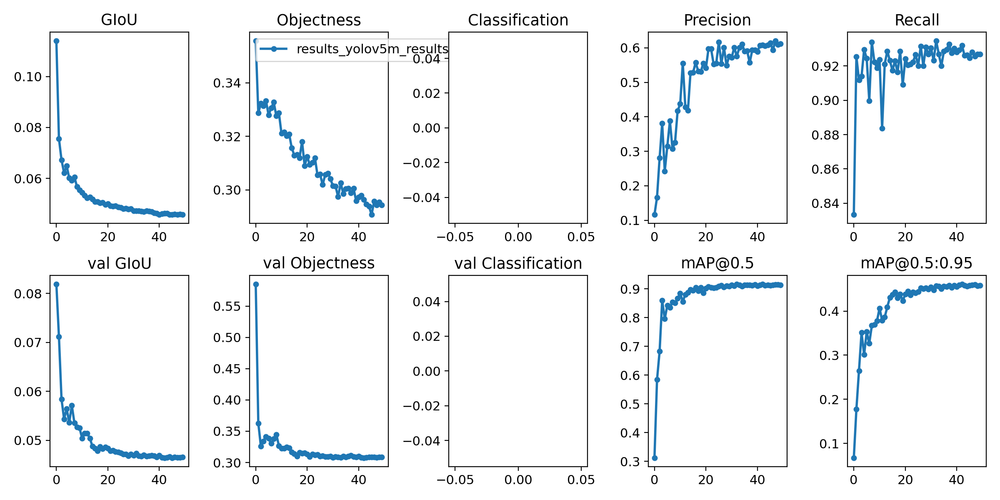

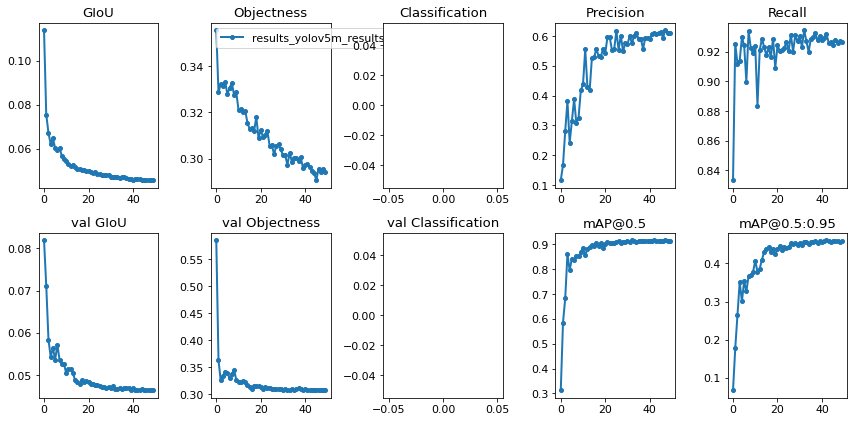

In [ ]:
# we can also output some older school graphs if the tensor board isn't working for whatever reason... 
from utils.utils import plot_results; plot_results()  # plot results.txt as results.png
Image(filename='./results.png', width=1000)  # view results.png

GROUND TRUTH TRAINING DATA:


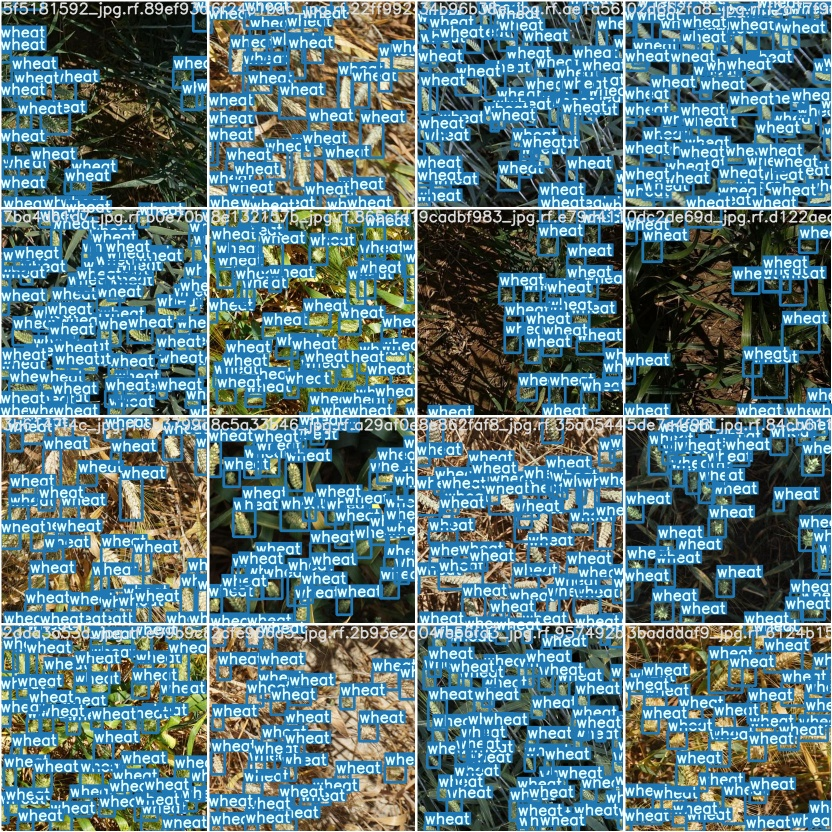

In [ ]:
# first, display our ground truth data
print("GROUND TRUTH TRAINING DATA:")
Image(filename='./test_batch0_gt.jpg', width=900)

GROUND TRUTH AUGMENTED TRAINING DATA:


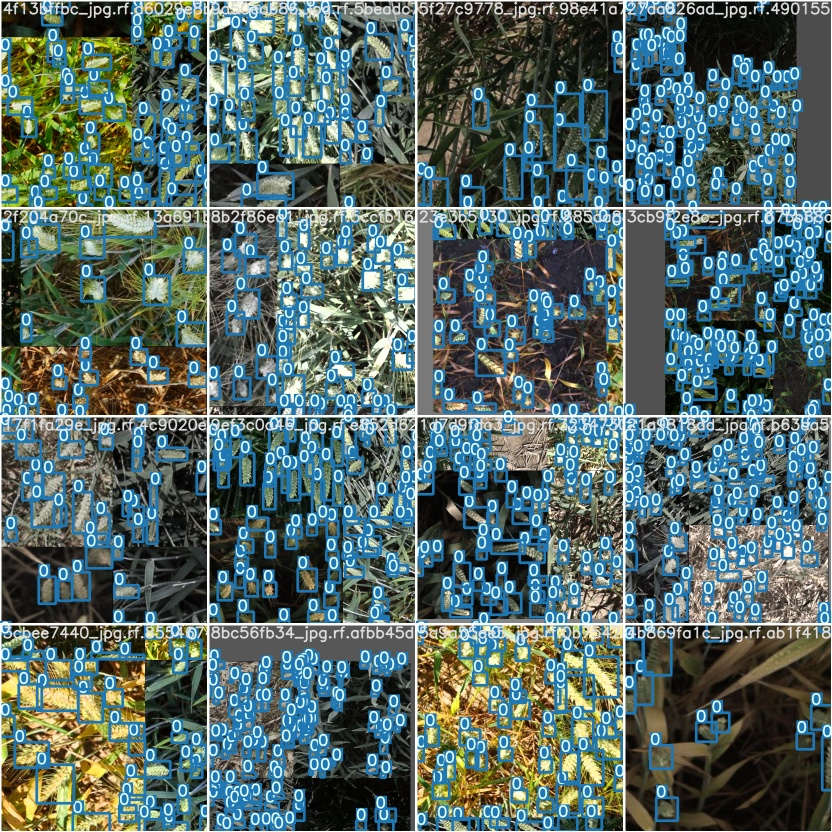

In [ ]:
# print out an augmented training example
print("GROUND TRUTH AUGMENTED TRAINING DATA:")
Image(filename='./train_batch2.jpg', width=900)

In [ ]:
# trained weights are saved by default in our weights folder
%ls weights/

download_weights.sh*  last_yolov5m_results.pt


In [ ]:
# when we ran this, we saw .007 second inference time. That is 140 FPS on a TESLA P100!
%cd /content/yolov5/
!python detect.py --weights weights/last_yolov5m_results.pt --img 416 --conf 0.4 --source ../test/images


/content/yolov5
Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.4, device='', img_size=416, iou_thres=0.5, output='inference/output', save_txt=False, source='../test/images', update=False, view_img=False, weights='weights/last_yolov5m_results.pt')
Using CUDA device0 _CudaDeviceProperties(name='Tesla P100-PCIE-16GB', total_memory=16280MB)

image 1/100 ../test/images/04f906b5d_jpg.rf.4ee7318146e5f2d750b733236bffec6f.jpg: 416x416 58 wheats, Done. (0.016s)
image 2/100 ../test/images/09d50b59d_jpg.rf.2e9d583c26df57adfb9c283a1484f412.jpg: 416x416 53 wheats, Done. (0.016s)
image 3/100 ../test/images/0a3cb453f_jpg.rf.9b36b1a6710eb856d1d72ed31e80f377.jpg: 416x416 65 wheats, Done. (0.016s)
image 4/100 ../test/images/0a4408b37_jpg.rf.815d5c7663557afe6a952639ee891de7.jpg: 416x416 35 wheats, Done. (0.015s)
image 5/100 ../test/images/0a7338e6f_jpg.rf.f020a1d6ecfe1a8fcdb86f6d25bc312b.jpg: 416x416 56 wheats, Done. (0.015s)
image 6/100 ../test/images/0a9f24bdc_jpg.rf.1c4d0ae0498

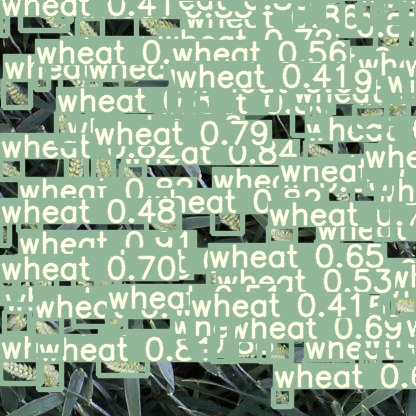

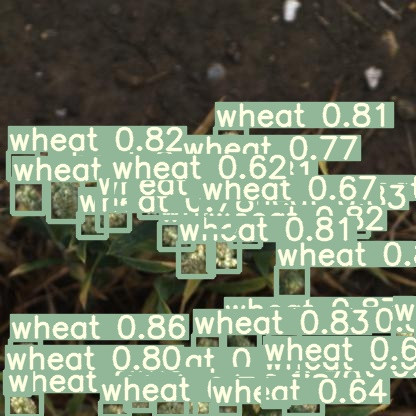

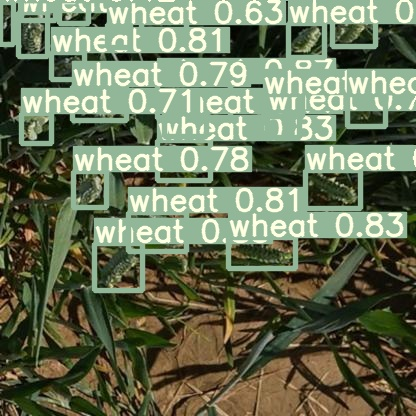

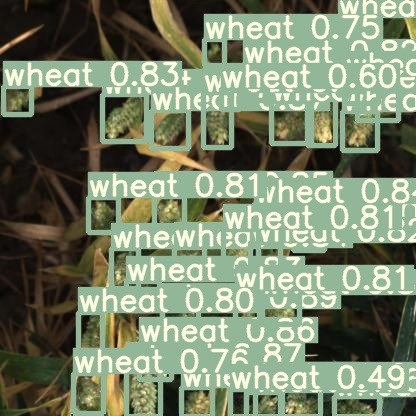

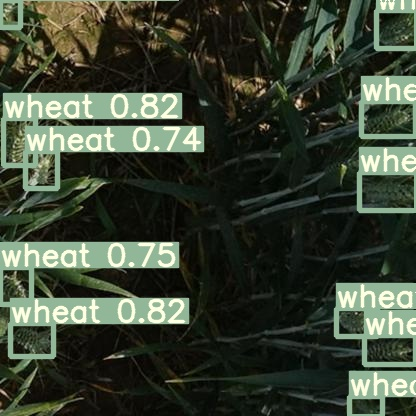

...

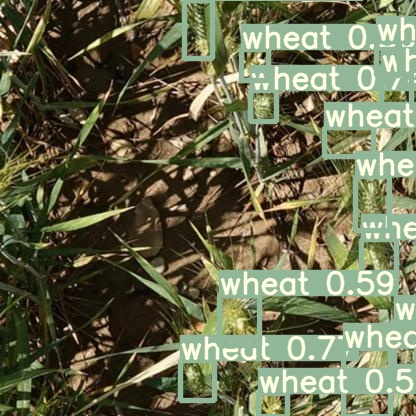

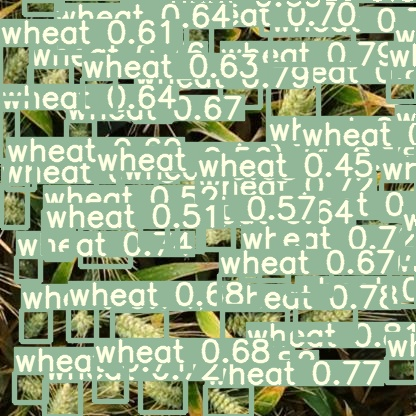

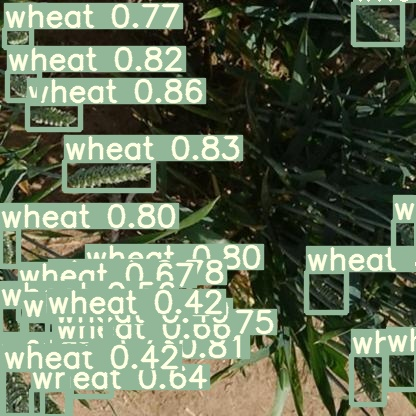

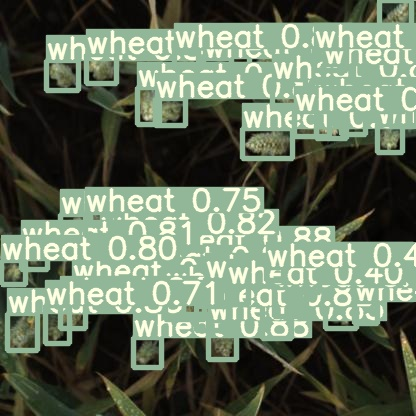

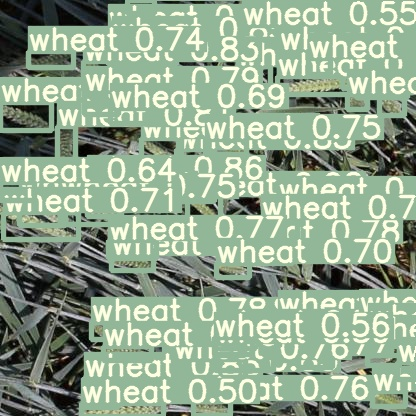

In [ ]:
#display inference on ALL test images
import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/inference/output/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

In [ ]:
%cp /content/yolov5/weights/last_yolov5m_results.pt /content/gdrive/My\ Drive

In [ ]:
!python detect.py --weights weights/last_yolov5m_results.pt --img 416 --conf 0.4 --source final_test


Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.4, device='', img_size=416, iou_thres=0.5, output='inference/output', save_txt=False, source='final_test', update=False, view_img=False, weights='weights/last_yolov5m_results.pt')
Using CUDA device0 _CudaDeviceProperties(name='Tesla P100-PCIE-16GB', total_memory=16280MB)

image 1/10 final_test/2fd875eaa.jpg: 416x416 27 wheats, Done. (0.016s)
image 2/10 final_test/348a992bb.jpg: 416x416 38 wheats, Done. (0.016s)
image 3/10 final_test/51b3e36ab.jpg: 416x416 26 wheats, Done. (0.016s)
image 4/10 final_test/51f1be19e.jpg: 416x416 24 wheats, Done. (0.016s)
image 5/10 final_test/53f253011.jpg: 416x416 30 wheats, Done. (0.016s)
image 6/10 final_test/796707dd7.jpg: 416x416 27 wheats, Done. (0.015s)
image 7/10 final_test/aac893a91.jpg: 416x416 24 wheats, Done. (0.016s)
image 8/10 final_test/cb8d261a3.jpg: 416x416 24 wheats, Done. (0.015s)
image 9/10 final_test/cc3532ff6.jpg: 416x416 30 wheats, Done. (0.015s)
image 10/10 fina

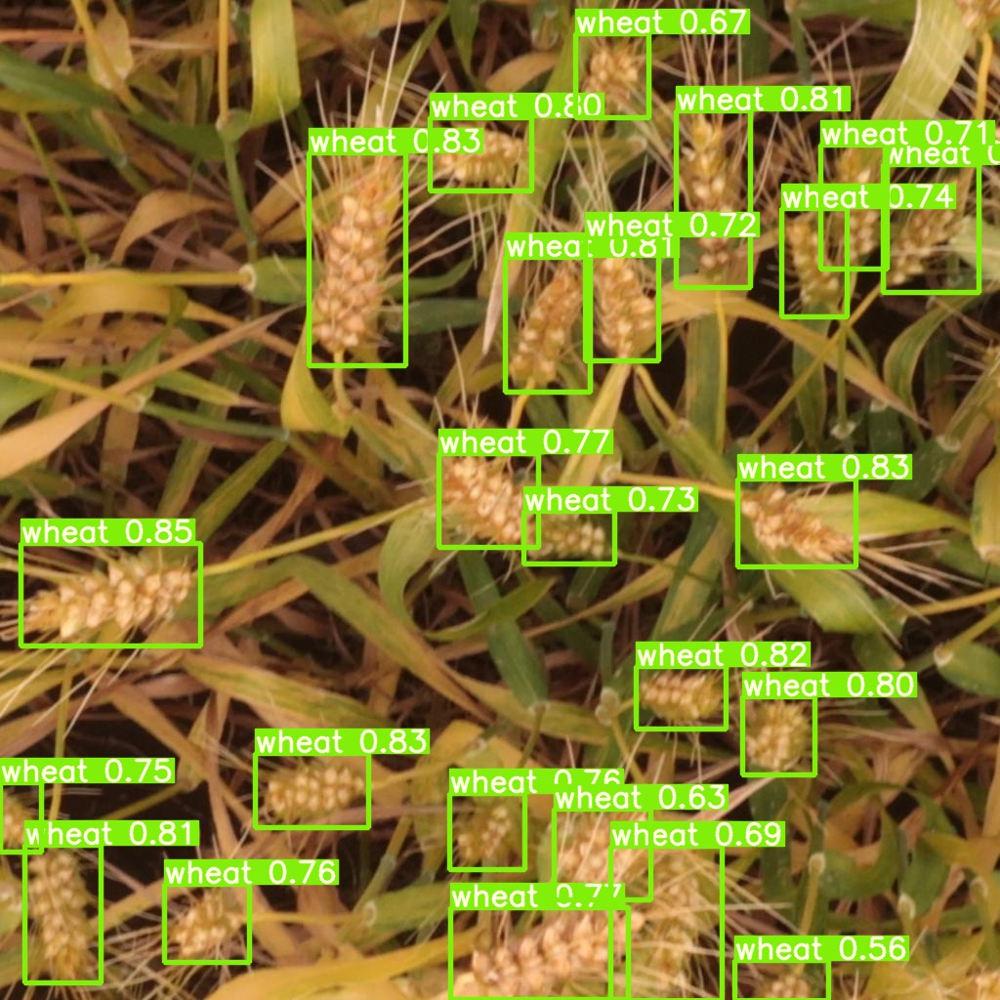

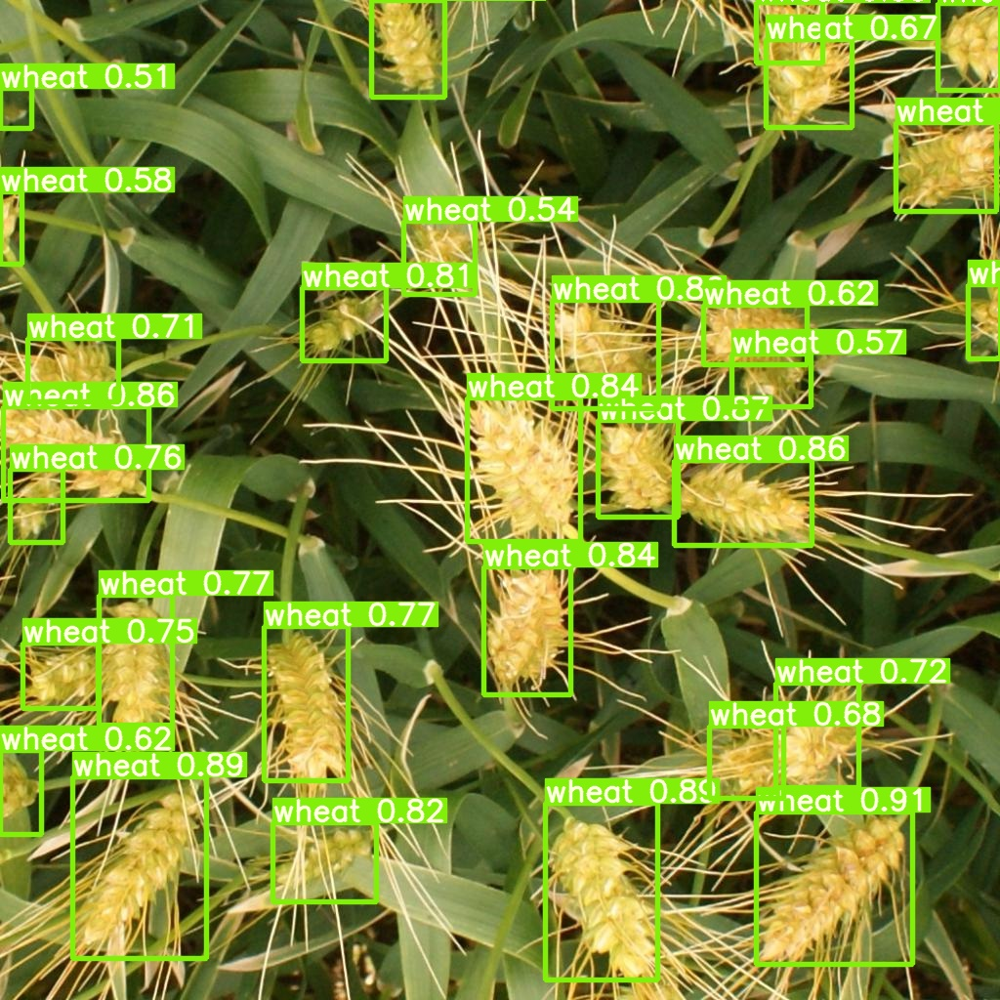

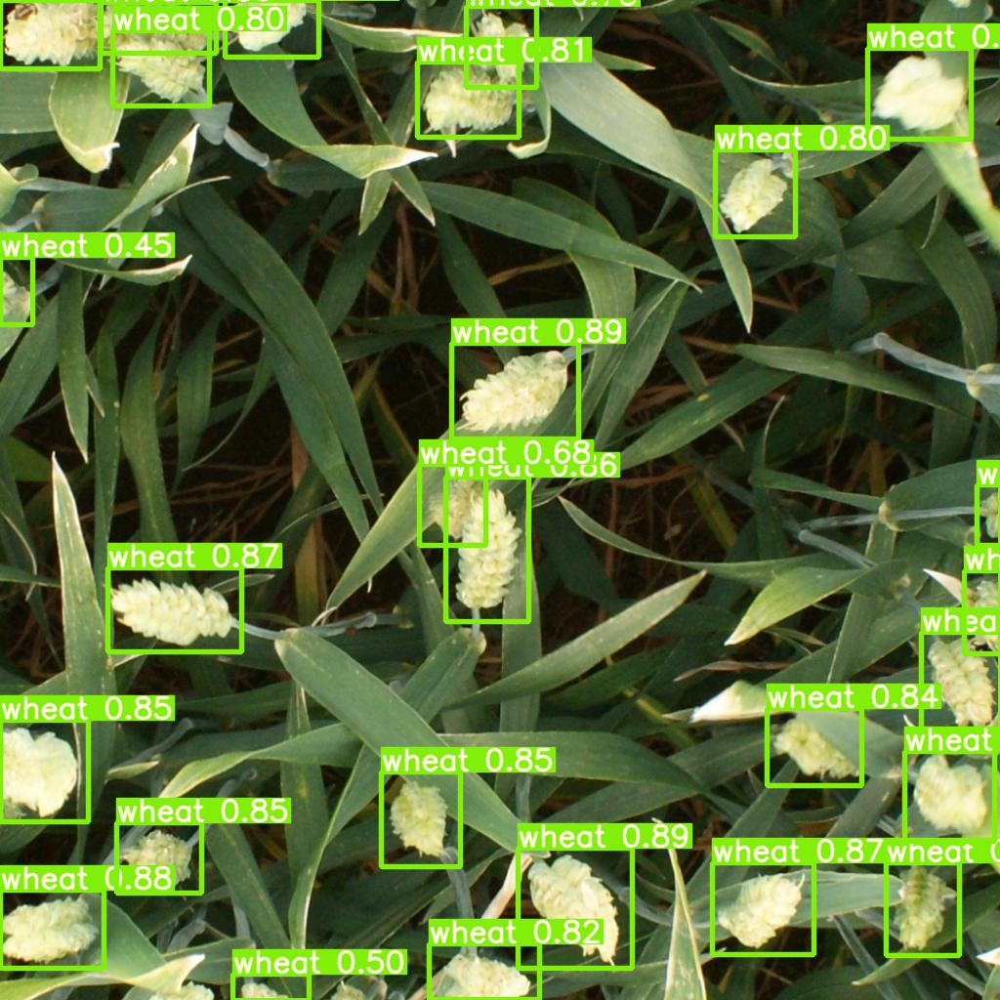

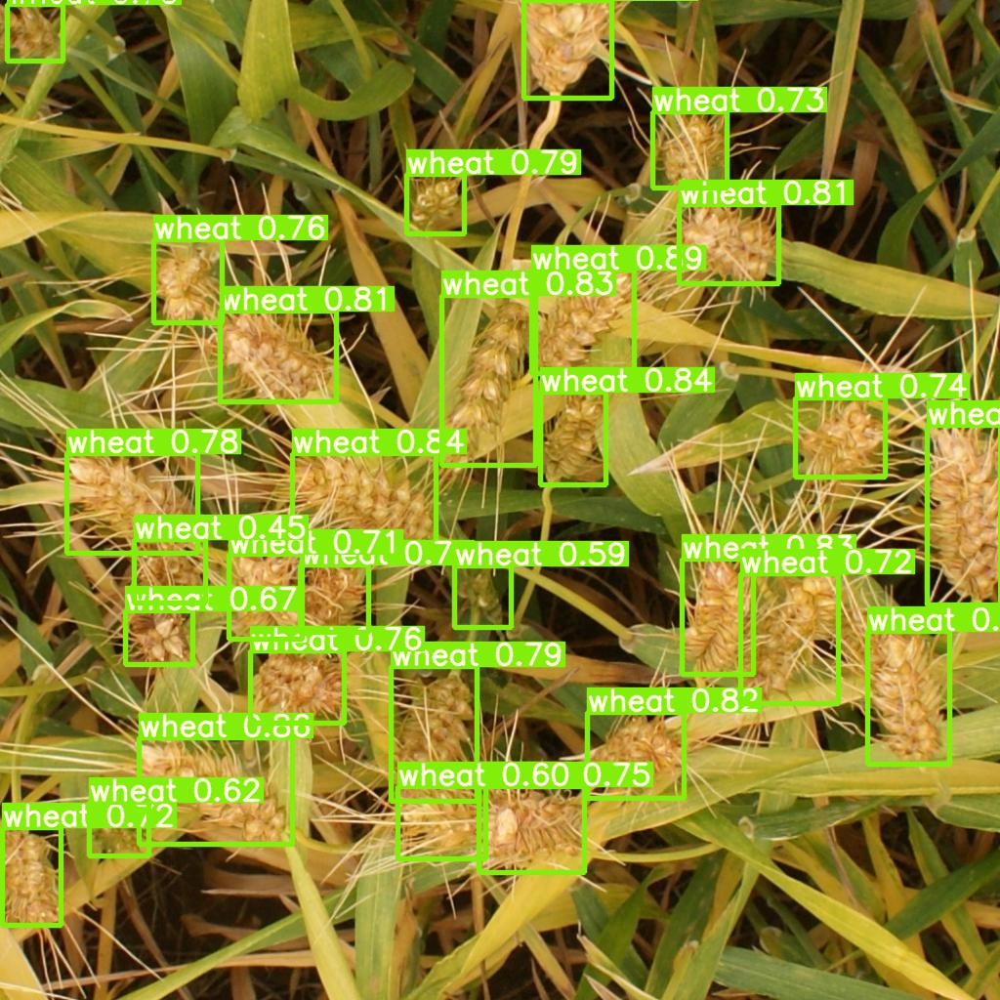

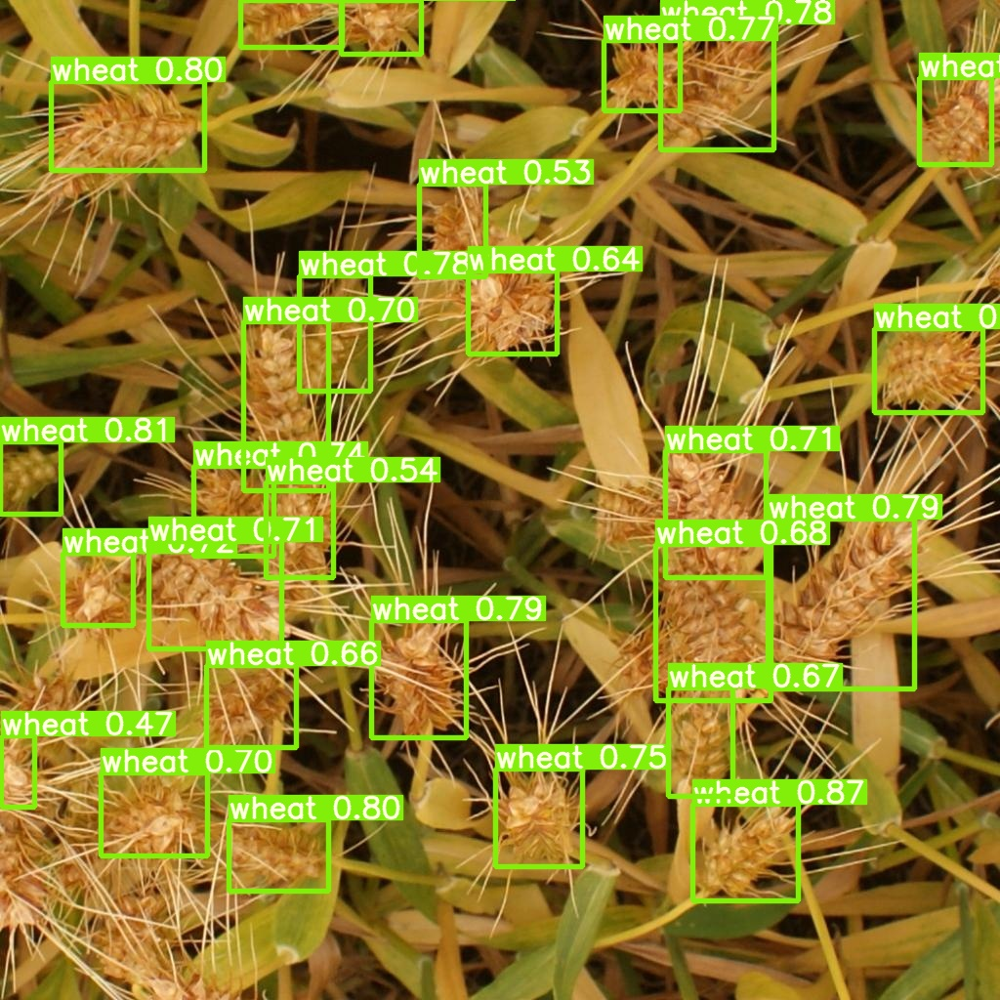

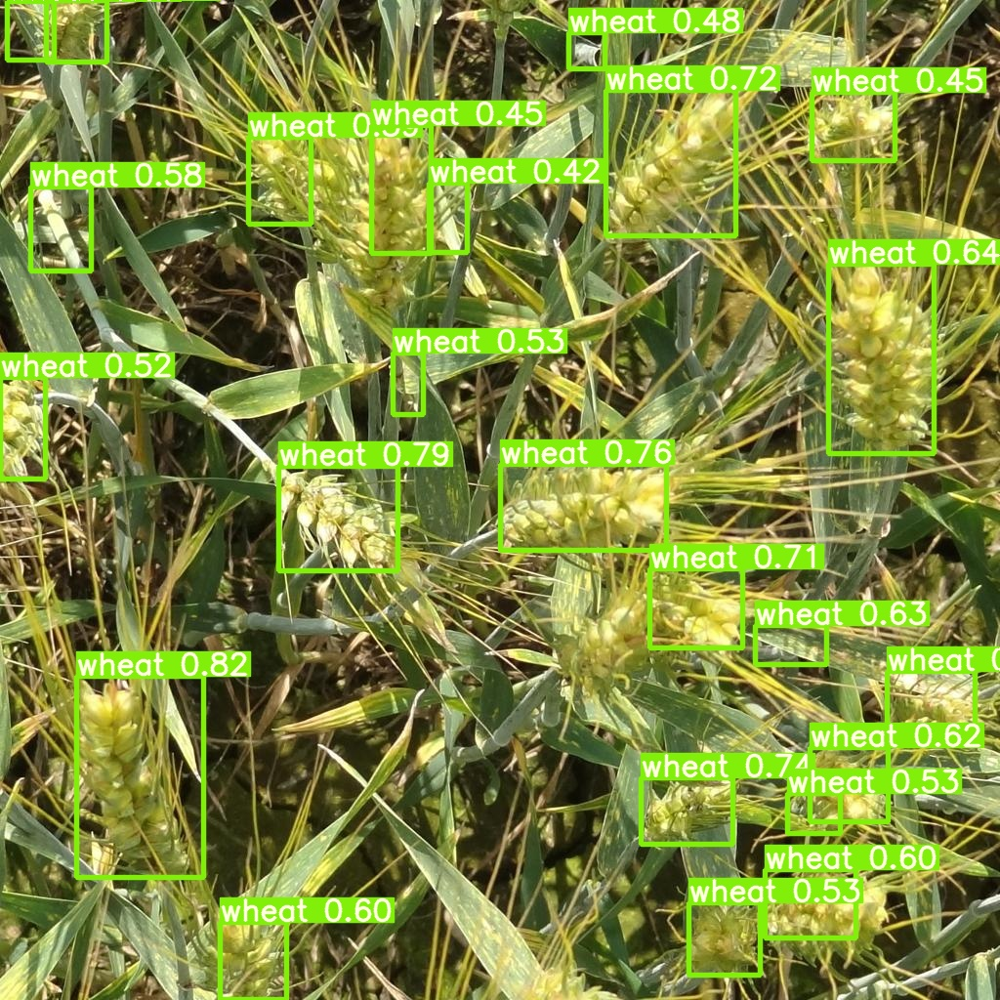

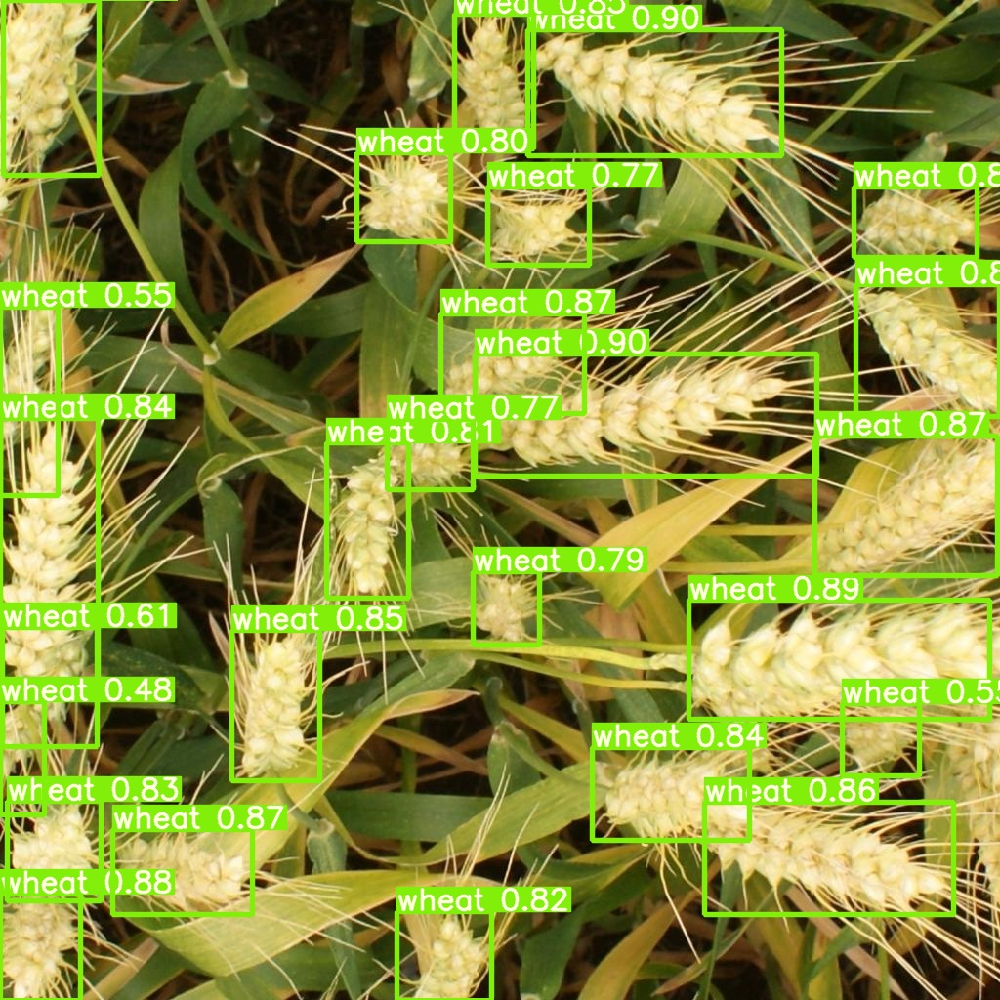

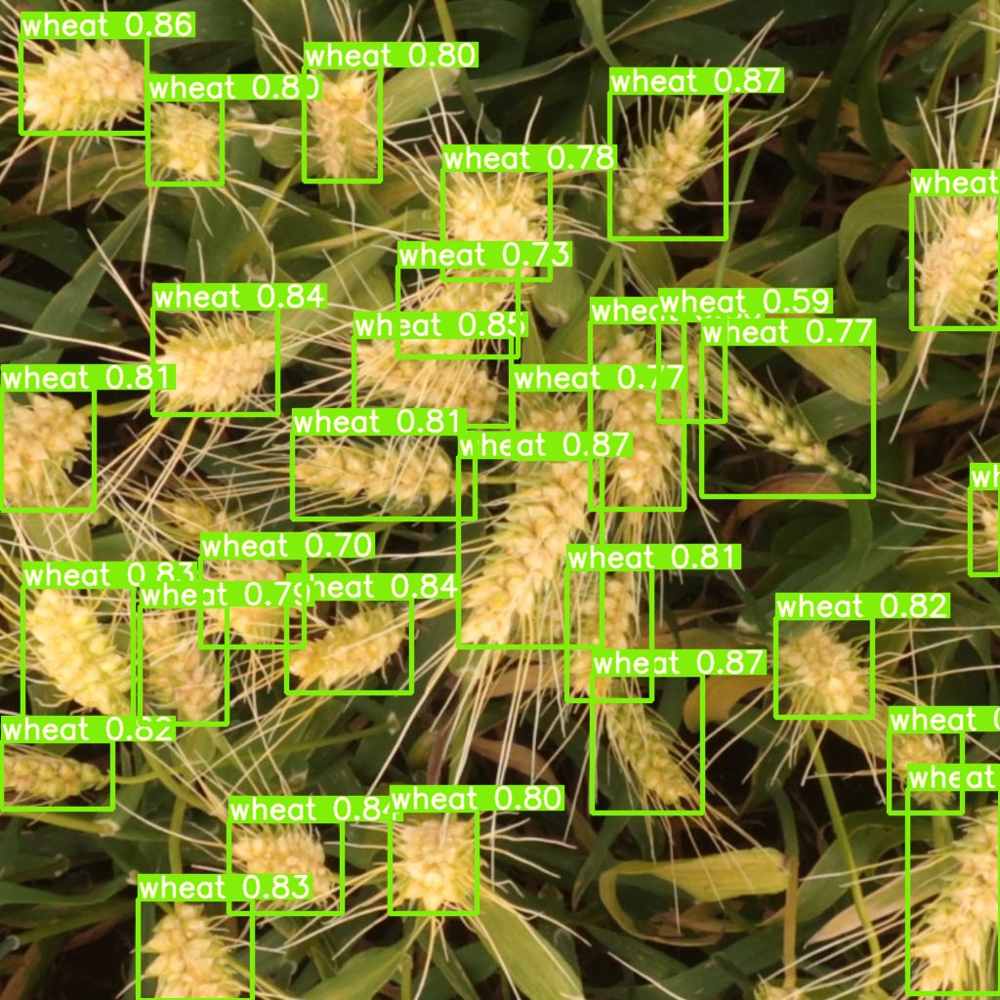

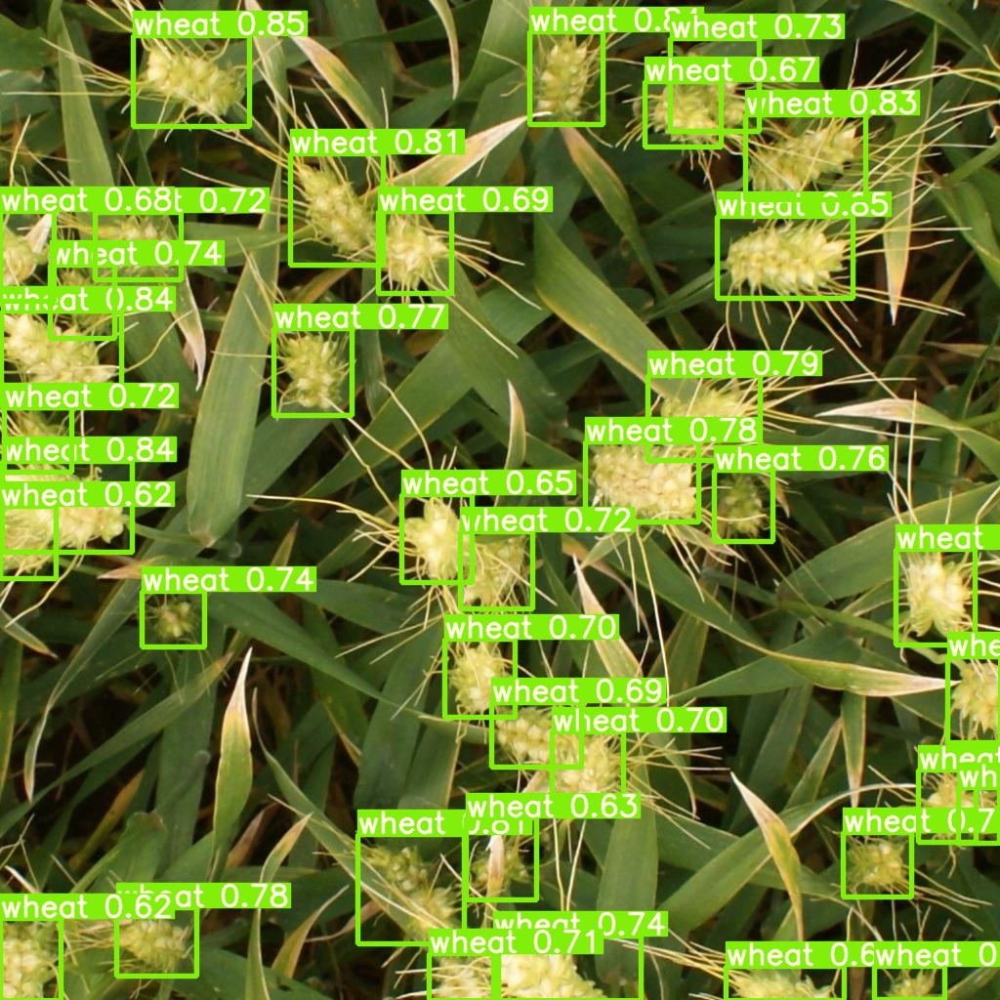

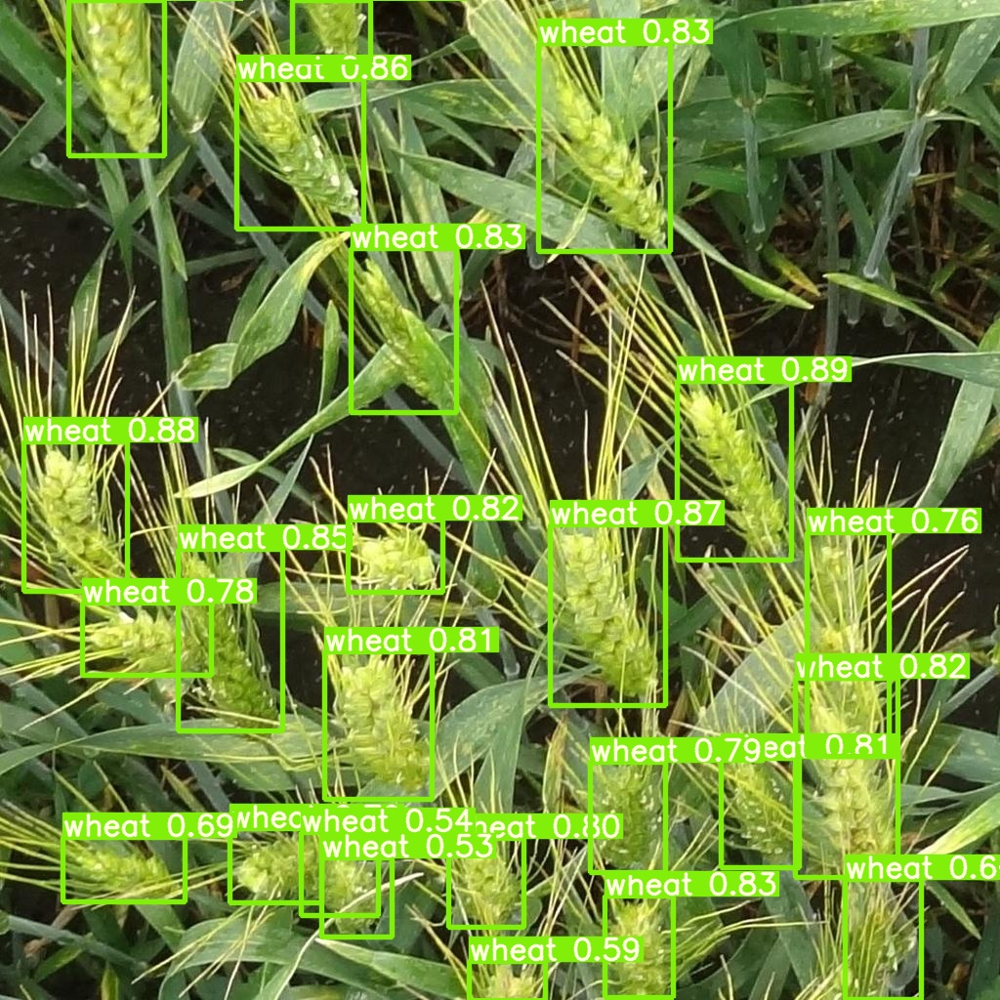

In [ ]:
#display inference on ALL test images
import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/inference/output/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")